<a href="https://colab.research.google.com/github/Limkyuchan/Djano_Class/blob/main/Team_Project_03_01.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# 구글 드라이브 마운트 (구글 코랩과 구글 드라이브 연결)
from google.colab import drive
import os

drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
# 작업 경로 MyDrive로 변경 (구글드라이브 접속 후 바로 작업 디렉토리 확인 가능)

print('현재 작업 경로 : ', os.getcwd())
os.chdir('/content/drive/MyDrive')
print('변경된 작업 경로 : ', os.getcwd())

현재 작업 경로 :  /content
변경된 작업 경로 :  /content/drive/MyDrive


In [ ]:
# yolov5 레퍼지토리 다운로드

!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt
%pip install -q roboflow

fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/drive/MyDrive/yolov5


In [ ]:
# 사용할 데이터셋 경로 및 데이터셋의 yaml 파일 경로 지정
data_dir = '/content/drive/MyDrive/dataset/Fitness'
data_yaml = '/content/drive/MyDrive/dataset/Fitness/data.yaml'

In [ ]:
data_yaml

'/content/drive/MyDrive/dataset/Fitness/data.yaml'

In [ ]:
# 데이터셋 yaml 파일 확인
import yaml

with open(data_yaml) as f:
  film = yaml.load(f, Loader=yaml.FullLoader)
  display(film)

{'train': '../train/images',
 'val': '../valid/images',
 'test': '../test/images',
 'nc': 13,
 'names': ['arm-curl',
  'back-extension',
  'cable-lat-pulldown',
  'chest-fly',
  'chest-press',
  'dip-chin-assist',
  'hip-abduction-adduction',
  'lat-pulldown',
  'leg-extension',
  'leg-press',
  'lying-down-leg-curl',
  'overhead-shoulder-press',
  'smith-machine'],
 'roboflow': {'workspace': 'miimeunm',
  'project': 'exercise-machine-team-project',
  'version': 1,
  'license': 'CC BY 4.0',
  'url': 'https://universe.roboflow.com/miimeunm/exercise-machine-team-project/dataset/1'}}

In [ ]:
# yaml 파일의 train, val 데이터가 있는 경로 수정 (기존 경로 -> 구글 드라이브에 저장된 경로로)

film['train'] = '/content/drive/MyDrive/dataset/Fitness/train/images'
film['val'] = '/content/drive/MyDrive/dataset/Fitness/test/images'

with open(data_yaml, 'w') as f:
  yaml.dump(film, f)

print('변경된 yaml 파일 : ')

with open(data_yaml) as f:
  film = yaml.load(f, Loader=yaml.FullLoader)
  display(film)

변경된 yaml 파일 : 


{'names': ['arm-curl',
  'back-extension',
  'cable-lat-pulldown',
  'chest-fly',
  'chest-press',
  'dip-chin-assist',
  'hip-abduction-adduction',
  'lat-pulldown',
  'leg-extension',
  'leg-press',
  'lying-down-leg-curl',
  'overhead-shoulder-press',
  'smith-machine'],
 'nc': 13,
 'roboflow': {'license': 'CC BY 4.0',
  'project': 'exercise-machine-team-project',
  'url': 'https://universe.roboflow.com/miimeunm/exercise-machine-team-project/dataset/1',
  'version': 1,
  'workspace': 'miimeunm'},
 'test': '../test/images',
 'train': '/content/drive/MyDrive/dataset/Fitness/train/images',
 'val': '/content/drive/MyDrive/dataset/Fitness/test/images'}

In [ ]:
!python train.py --img 416 --batch 16 --epochs 10 --data {data_yaml} --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/drive/MyDrive/dataset/Fitness/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=10, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-207-gdf48c20 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0,

In [ ]:
# 텐서보드 시작하기

%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
# 학습한 모델 테스트
test_data_dir = film['val']

train_exp_num = 5

In [ ]:
!python detect.py --weights runs/train/exp{train_exp_num}/weights/best.pt --img 416 --conf 0.1 --source {test_data_dir}

detect: weights=['runs/train/exp5/weights/best.pt'], source=/content/drive/MyDrive/dataset/Fitness/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-207-gdf48c20 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7045186 parameters, 0 gradients, 15.9 GFLOPs
image 1/172 /content/drive/MyDrive/dataset/Fitness/test/images/zArmCurlMuchine07_jpg.rf.24c83c3bf624fd8b802dbb720c731882.jpg: 416x416 1 arm-curl, 7.5ms
image 2/172 /content/drive/MyDrive/dataset/Fitness/test/images/zArmCurlMuchine101_jpg.rf.a6ad19207951448b5eb6f67f71712b5e.jpg: 416x416 1 arm-curl, 1 leg-extension,

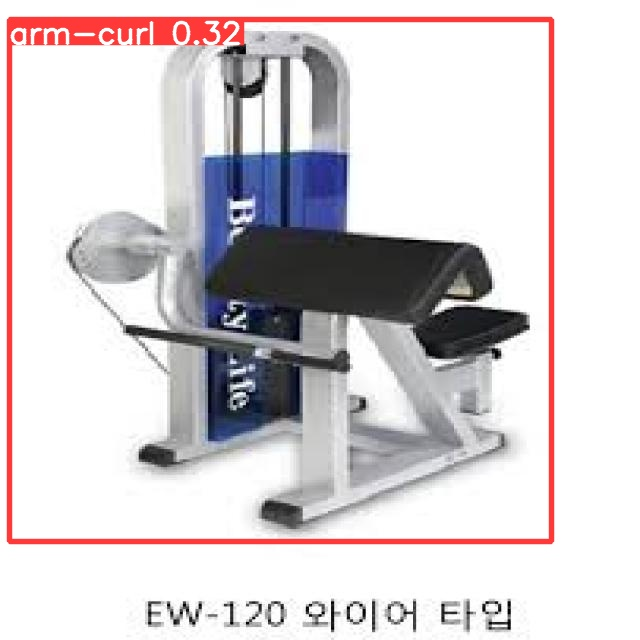

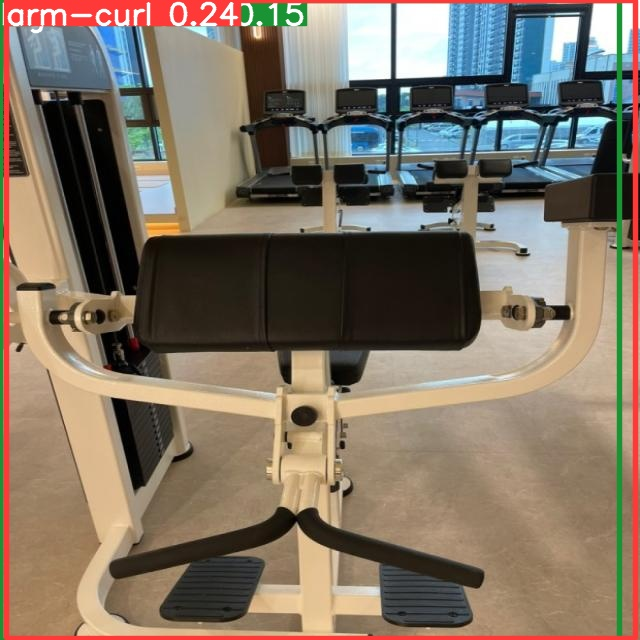

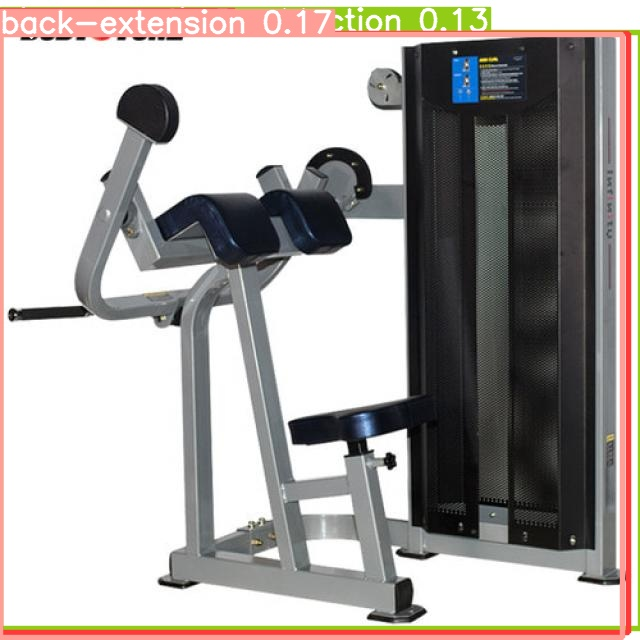

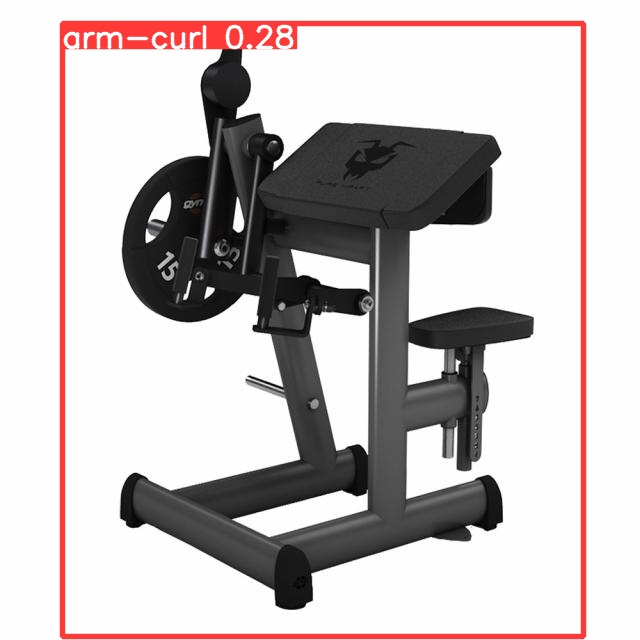

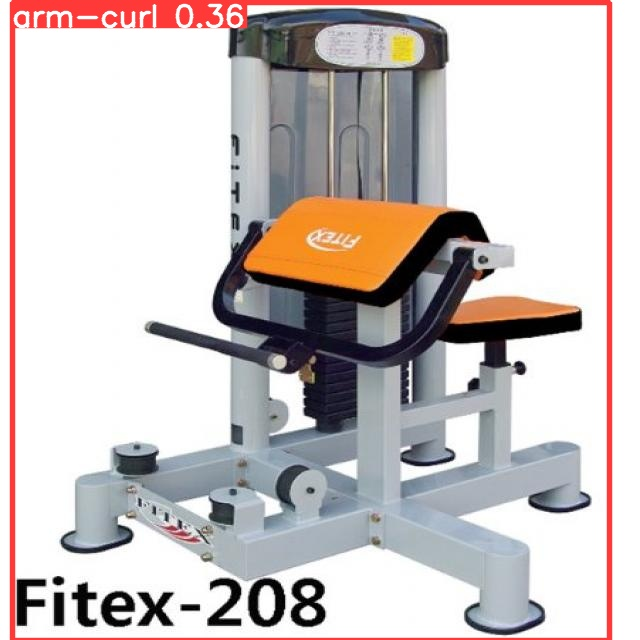

...

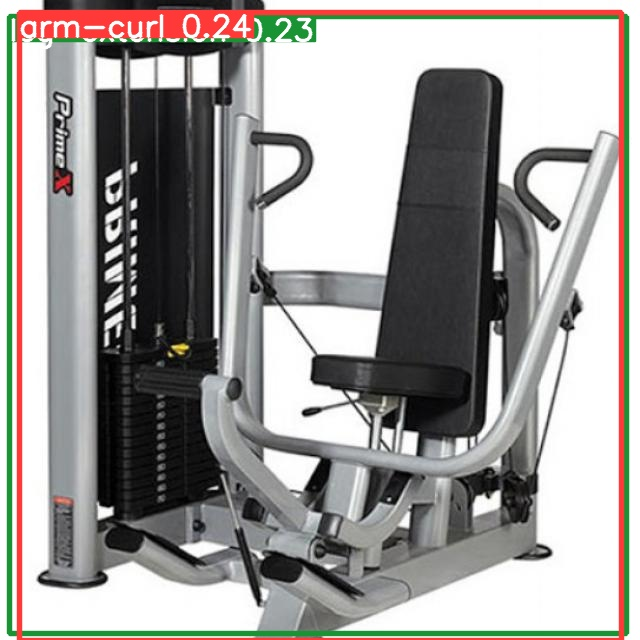

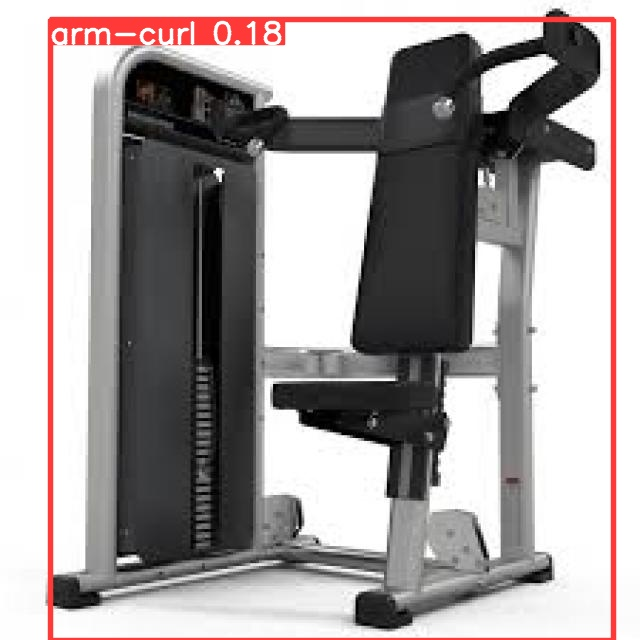

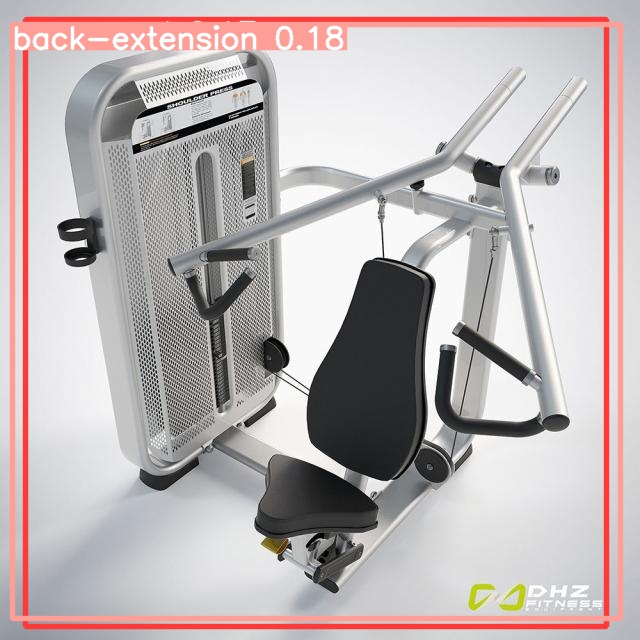

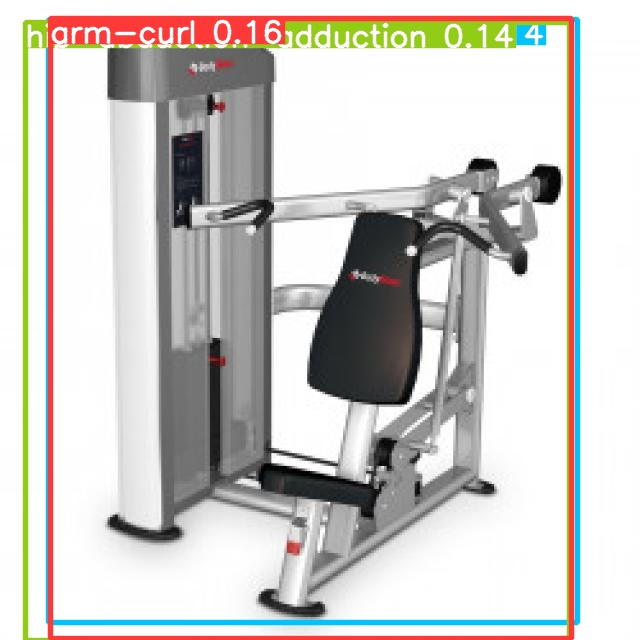

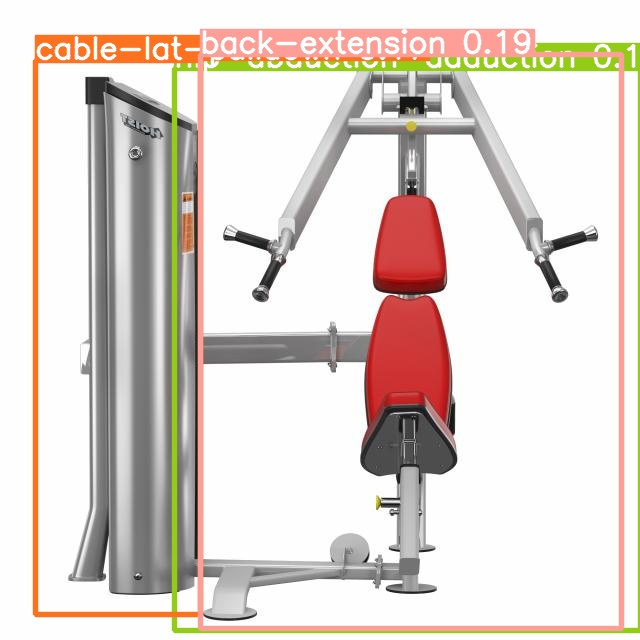

In [ ]:
# 테스트 결과 확인해보기
import glob
from IPython.display import Image, display

if not os.path.exists('/content/drive/MyDrive/yolov5/runs/detect/exp3/'):
  raise Exception('파일(detect/exp3)을 다시 확인하세요')

for imageName in glob.glob('/content/drive/MyDrive/yolov5/runs/detect/exp3/*.jpg'):
  display(Image(filename = imageName))
  print("\n")